In [1]:
import GraphST

In [2]:
import os
import torch
import pandas as pd
import scanpy as sc
from sklearn import metrics
import multiprocessing as mp

In [3]:
file_fold = r"D:\project\Visium_HD_Human_Lung_Cancer_binned_outputs\binned_outputs\square_008um"


In [4]:
adata = sc.read_visium(file_fold, count_file='filtered_feature_bc_matrix.h5', load_images=True)
adata.var_names_make_unique()


C:\Users\suhas\anaconda3\envs\GraphST\lib\site-packages\anndata\_core\anndata.py:1756: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\suhas\anaconda3\envs\GraphST\lib\site-packages\anndata\_core\anndata.py:1756: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\suhas\anaconda3\envs\GraphST\lib\site-packages\scanpy\readwrite.py:482: DtypeWarning: Columns (1,2,3,4,5) have mixed types. Specify dtype option on import or set low_memory=False.
  positions = pd.read_csv(


In [5]:
adata

AnnData object with n_obs × n_vars = 605471 × 18085
    obs: 'in_tissue', 'array_row', 'array_col'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [6]:
adata.obsm["spatial"] = adata.obsm["spatial"].astype(float)

In [7]:
device = torch.device('cuda:1' if torch.cuda.is_available() else 'cpu')

In [8]:
print(device)

cpu


In [9]:
adata = adata[adata.obs["in_tissue"] == 1].copy()


In [10]:
x_min, x_max = 12000, 15000
y_min, y_max = 10000, 13000


In [11]:
mask = (
    (adata.obsm['spatial'][:, 0] >= x_min) & (adata.obsm['spatial'][:, 0] <= x_max) &
    (adata.obsm['spatial'][:, 1] >= y_min) & (adata.obsm['spatial'][:, 1] <= y_max)
)
adata = adata[mask].copy()
print(f"Subset shape: {adata.shape}")


Subset shape: (14880, 18085)


In [12]:
import torch

# Force correct device
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print("Using device:", device)


Using device: cpu


In [13]:
# define model
model = GraphST.GraphST(adata, device=device)

# train model
adata = model.train()

Begin to train ST data...


100%|██████████████████████████████████████████████████████████████████████████████| 600/600 [4:02:32<00:00, 24.25s/it]


Optimization finished for ST data!


In [14]:
n_clusters = 8

In [15]:
# set radius to specify the number of neighbors considered during refinement
radius = 50

tool = 'leiden' # mclust, leiden, and louvain

# clustering
from GraphST.utils import clustering

if tool == 'mclust':
   clustering(adata, n_clusters, radius=radius, method=tool, refinement=True) 
elif tool in ['leiden', 'louvain']:
   clustering(adata, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

Searching resolution...


C:\Users\suhas\anaconda3\envs\GraphST\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
D:\Projects\GraphST\GraphST\utils.py:223: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, random_state=0, resolution=res)


resolution=1.989999999999999, cluster number=20
resolution=1.979999999999999, cluster number=18
resolution=1.969999999999999, cluster number=19
resolution=1.959999999999999, cluster number=20
resolution=1.949999999999999, cluster number=18
resolution=1.939999999999999, cluster number=19
resolution=1.9299999999999993, cluster number=18
resolution=1.9199999999999993, cluster number=17
resolution=1.9099999999999993, cluster number=18
resolution=1.8999999999999992, cluster number=16
resolution=1.8899999999999992, cluster number=18
resolution=1.8799999999999992, cluster number=16
resolution=1.8699999999999992, cluster number=16
resolution=1.8599999999999992, cluster number=17
resolution=1.8499999999999992, cluster number=17
resolution=1.8399999999999992, cluster number=16
resolution=1.8299999999999992, cluster number=16
resolution=1.8199999999999992, cluster number=15
resolution=1.8099999999999992, cluster number=16
resolution=1.7999999999999992, cluster number=18
resolution=1.7899999999999

<Axes: title={'center': 'Predicted labels'}, xlabel='UMAP1', ylabel='UMAP2'>

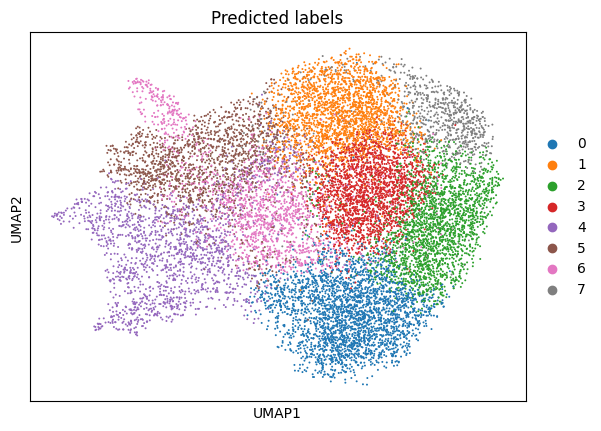

In [16]:
# plotting predicted labels by UMAP
sc.pp.neighbors(adata, use_rep='emb_pca', n_neighbors=10)
sc.tl.umap(adata)
sc.pl.umap(adata, color='domain', title=['Predicted labels'], show=False)

<Axes: title={'center': 'Predicted labels'}, xlabel='UMAP1', ylabel='UMAP2'>

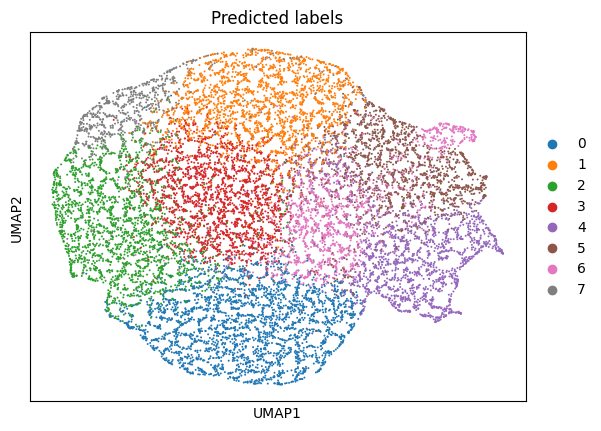

In [17]:

# plotting predicted labels by UMAP
sc.pp.neighbors(adata, use_rep='X_umap', n_neighbors=10)
sc.tl.umap(adata)
sc.pl.umap(adata, color='domain', title=['Predicted labels'], show=False)

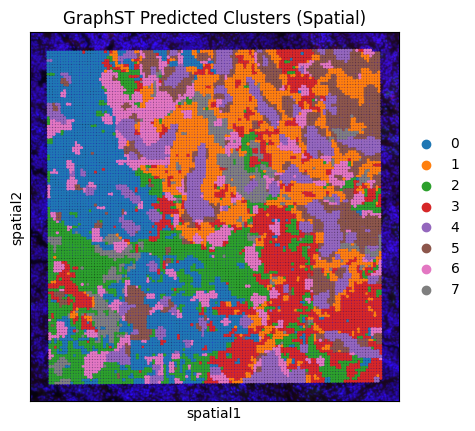

In [18]:
import scanpy as sc

sc.pl.spatial(
    adata,
    img_key="hires",
    color="domain",
    title="GraphST Predicted Clusters (Spatial)",
    spot_size=30,            # increased for HD
           # increase transparency
    cmap="tab20",            # clear categorical colors
    show=True
)


In [19]:
# Extract GraphST cluster color codes
graphst_colors = adata.uns["domain_colors"]
print("GraphST Cluster Colors:")
print(graphst_colors)


GraphST Cluster Colors:
['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f']


<Axes: title={'center': 'Predicted labels'}, xlabel='UMAP1', ylabel='UMAP2'>

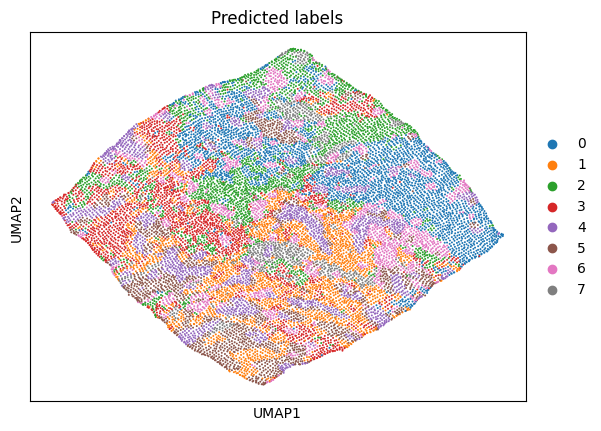

In [20]:
sc.pp.neighbors(adata, use_rep='spatial', n_neighbors=10)
sc.tl.umap(adata)
sc.pl.umap(adata, color='domain', title=['Predicted labels'], show=False)

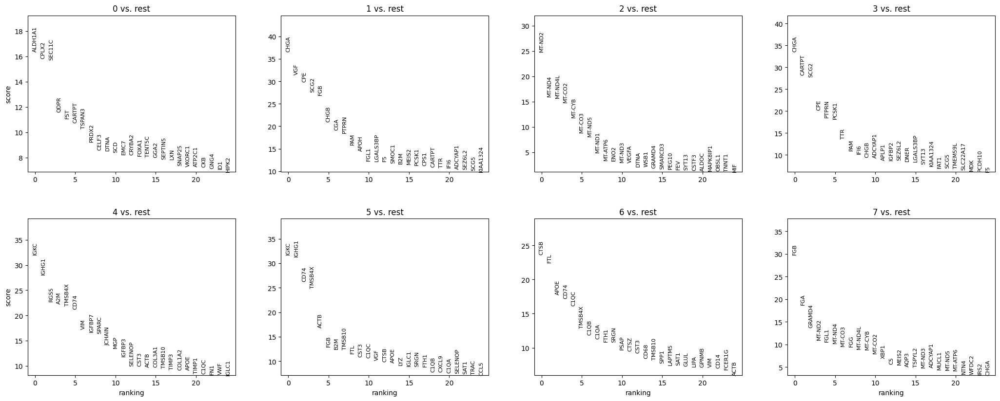

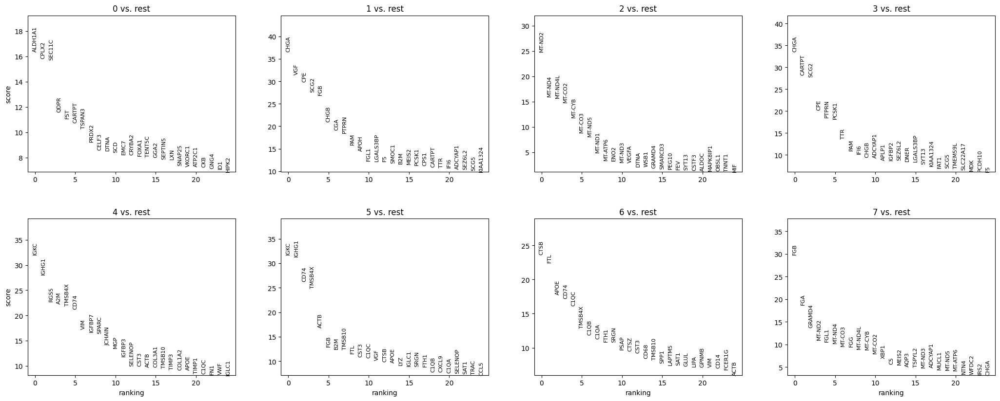

In [21]:
# For GraphST clusters
sc.tl.rank_genes_groups(
    adata,
    groupby="domain",
    method="wilcoxon"
)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, title="GraphST Cluster Markers")

# For Leiden clusters
sc.tl.rank_genes_groups(
    adata,
    groupby="leiden",
    method="wilcoxon"
)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, title="Leiden Cluster Markers")


## Plots top 10 spatially variable genes across tissue using Moran's I.
### Moran’s I measures spatial autocorrelation, indicating whether similar gene expression values cluster together or disperse across spatial locations.


In [22]:
import squidpy as sq

sq.gr.spatial_neighbors(adata)


C:\Users\suhas\anaconda3\envs\GraphST\lib\site-packages\xarray_schema\__init__.py:1: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  from pkg_resources import DistributionNotFound, get_distribution
C:\Users\suhas\anaconda3\envs\GraphST\lib\site-packages\requests\__init__.py:86: RequestsDependencyWarning: Unable to find acceptable character detection dependency (chardet or charset_normalizer).
  warnings.warn(
C:\Users\suhas\anaconda3\envs\GraphST\lib\site-packages\numba\core\decorators.py:246: RuntimeWarning: nopython is set for njit and is ignored
  warnings.warn('nopython is set for njit and is ignored', RuntimeWarning)


In [23]:
sq.gr.spatial_autocorr(adata, mode="moran")


In [24]:
top_genes = adata.uns["moranI"].sort_values("I", ascending=False).head(20).index.tolist()
print("Top spatially variable genes by Moran's I:", top_genes)


Top spatially variable genes by Moran's I: ['IGKC', 'IGHG1', 'IGLC1', 'IGHG3', 'JCHAIN', 'VGF', 'FGB', 'RGS5', 'IGHA1', 'CD74', 'IGFBP3', 'IGHM', 'CGA', 'TMSB4X', 'SPARC', 'ENPP2', 'CXCL9', 'APOE', 'FGA', 'A2M']


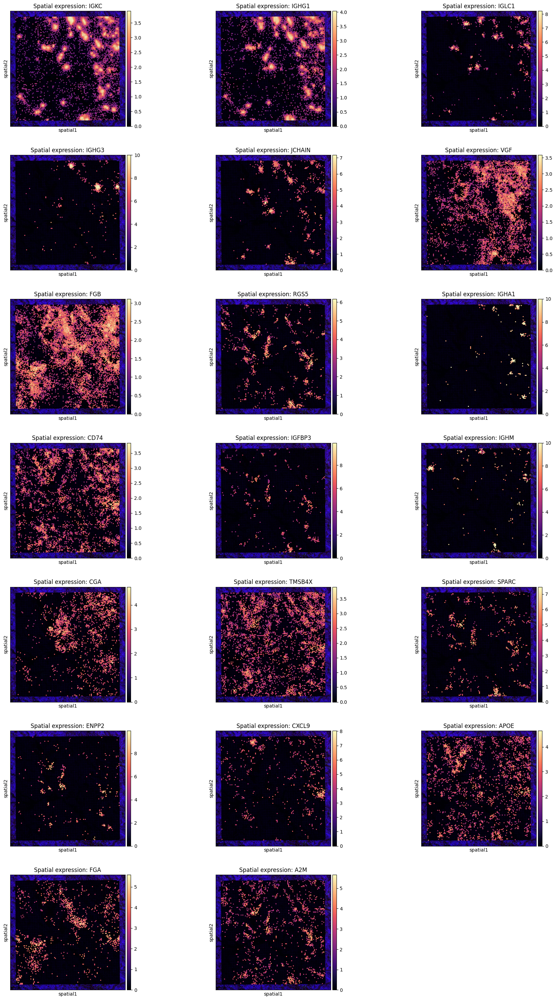

In [25]:
import scanpy as sc

sc.pl.spatial(
    adata,
    color=top_genes,
    cmap="magma",
    spot_size=30,
    ncols=3,
    title=[f"Spatial expression: {gene}" for gene in top_genes]
)


In [26]:
import squidpy as sq

sq.gr.spatial_neighbors(adata)


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [01:51<00:00, 111.50s/]


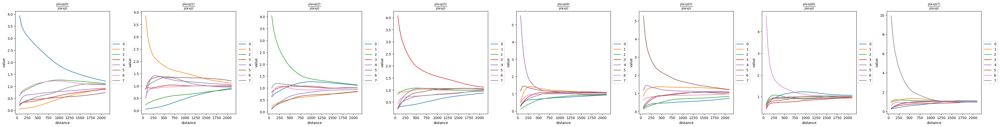

In [27]:
sq.gr.co_occurrence(adata, cluster_key="domain")
sq.pl.co_occurrence(adata, cluster_key="domain")


100%|████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:13<00:00, 76.42/s]


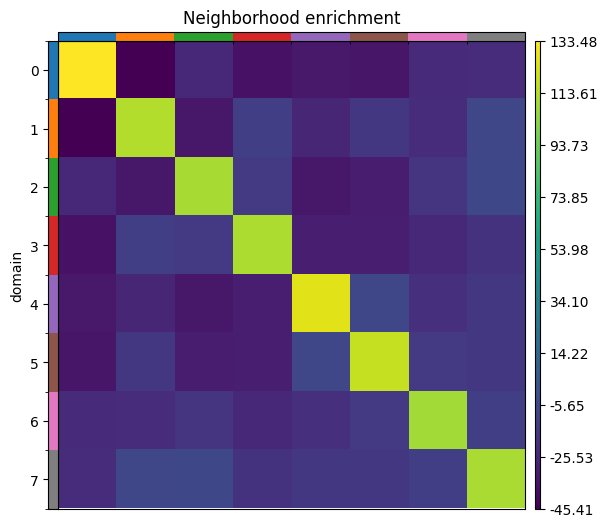

In [28]:
sq.gr.nhood_enrichment(adata, cluster_key="domain")
sq.pl.nhood_enrichment(adata, cluster_key="domain")


## PAGA estimates connectivity between clusters in a graph-based manner. It helps interpret transitions, proximities, and modularity in high-dimensional data — such as cell or spatial transcriptomics clusters

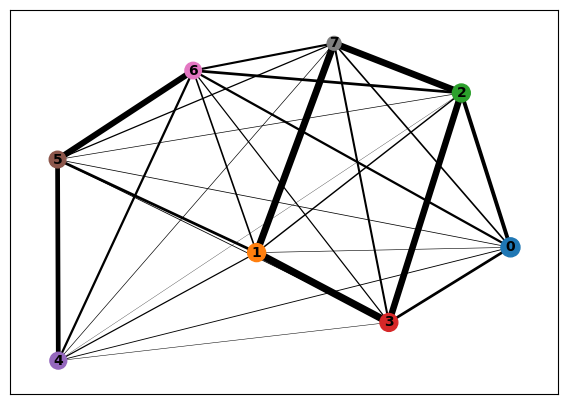

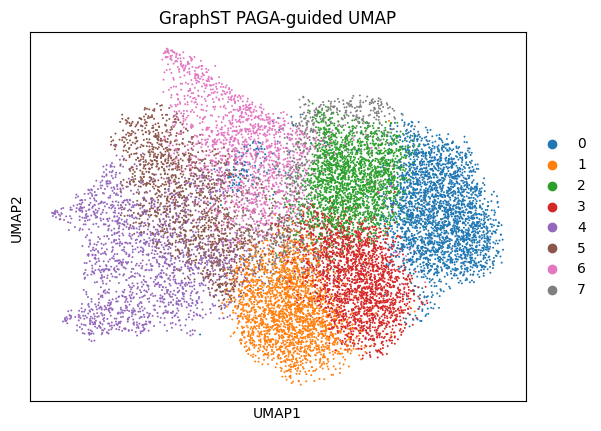

In [29]:
sc.pp.neighbors(adata, use_rep='emb_pca')  # GraphST latent space
sc.tl.paga(adata, groups='domain')

# Plot PAGA
sc.pl.paga(adata, color='domain')

#  UMAP using PAGA for structure-preserving visualization
sc.tl.umap(adata, init_pos='paga')
sc.pl.umap(adata, color='domain', title='GraphST PAGA-guided UMAP')


In [30]:
import pandas as pd

def count_significant_genes(adata, pval_threshold=0.05):
    result = adata.uns['rank_genes_groups']
    groups = result['names'].dtype.names
    counts = []

    for group in groups:
        pvals = result['pvals_adj'][group]
        num_significant = (pvals < pval_threshold).sum()
        counts.append({'cluster': group, 'significant_genes': num_significant})

    return pd.DataFrame(counts)

# Example usage
significant_counts_df = count_significant_genes(adata, pval_threshold=0.05)
print(significant_counts_df)


  cluster  significant_genes
0       0                437
1       1                121
2       2                 92
3       3                 79
4       4                269
5       5                 99
6       6                 64
7       7                 34


In [31]:
import pandas as pd

def get_all_ranked_genes(adata):
    result = adata.uns['rank_genes_groups']
    groups = result['names'].dtype.names
    dfs = []
    for group in groups:
        n_genes = len(result['names'][group])
        df = pd.DataFrame({
            'cluster': group,
            'gene': result['names'][group],
            'logfc': result['logfoldchanges'][group],
            'pval_adj': result['pvals_adj'][group]
        }, index=range(n_genes))
        dfs.append(df)
    return pd.concat(dfs, ignore_index=True)

top_markers = get_all_ranked_genes(adata)


In [33]:
import pandas as pd
import gseapy as gp

sig_markers = top_markers[top_markers['pval_adj'] < 0.05]


significant_genes_by_cluster = sig_markers.groupby('cluster')['gene'].apply(list).to_dict()


for cluster, genes in significant_genes_by_cluster.items():
    enr = gp.enrichr(
        gene_list=genes,
        gene_sets='GO_Biological_Process_2021',
        organism='Human',
        outdir=None,
        cutoff=0.5  
    )
    print(f"\nTop enriched GO terms for cluster {cluster}:")
    print(enr.results[['Term', 'Adjusted P-value']].head())



Top enriched GO terms for cluster 0:
                                                Term  Adjusted P-value
0                  regulated exocytosis (GO:0045055)      4.000547e-09
1      aerobic electron transport chain (GO:0019646)      2.743200e-08
2  mitochondrial ATP synthesis coupled electron t...      2.743200e-08
3                platelet degranulation (GO:0002576)      1.407014e-06
4  mitochondrial electron transport, NADH to ubiq...      7.007165e-05

Top enriched GO terms for cluster 1:
                                                Term  Adjusted P-value
0                platelet degranulation (GO:0002576)      2.081249e-08
1                  regulated exocytosis (GO:0045055)      7.427289e-07
2  post-translational protein modification (GO:00...      6.327824e-04
3     extracellular matrix organization (GO:0030198)      8.107591e-04
4             cell junction disassembly (GO:0150146)      1.298492e-03

Top enriched GO terms for cluster 2:
                                  

## Labels

Cluster 0 — "Secretory/Metabolic"
GO: regulated exocytosis, ATP synthesis, platelet degranulation

Indicates high secretory + metabolic activity, likely secretory cells or active mitochondria.

Cluster 1 — "ECM + Exocytosis"
GO: platelet degranulation, ECM organization, protein modification

Mix of extracellular matrix and secretion-related terms — possibly vascular cells or matrix-interacting cells.

Cluster 2 — "Platelet-Immune"
GO: platelet degranulation, neutrophil immunity

Suggests dual role in hemostasis and early immune response.

Cluster 3 — "Exocytosis + Signaling"
GO: hepatocyte proliferation, cell junction disassembly, regulated exocytosis

Functionally active signaling hub — possibly interface region between stromal and immune zones.

Cluster 4 — "ECM-Remodeling/Stromal"
GO: ECM structure, collagen, external encapsulating structure

Highly enriched in fibroblast-like, stromal, or CAF-related functions.

Cluster 5 — "Neutrophil/Immune"
GO: neutrophil degranulation, cytokine signaling

Indicates active innate immune zones, likely neutrophil-rich.

Cluster 6 — "Antigen Presentation"
GO: MHC-II antigen presentation, neutrophil activation

Enriched in adaptive immune processes, likely involving antigen-presenting cells.

Cluster 7 — "Apoptosis/Signaling"
GO: endothelial cell apoptosis, ERK cascade, plasminogen activation

Likely endothelial or signaling-active zones, potentially vascular or damaged regions.



In [34]:
cluster_labels = {
    '0': 'Secretory/Metabolic',
    '1': 'ECM + Exocytosis',
    '2': 'Platelet-Immune',
    '3': 'Exocytosis + Signaling',
    '4': 'ECM-Remodeling/Stromal',
    '5': 'Neutrophil/Immune',
    '6': 'Antigen Presentation',
    '7': 'Apoptosis/Signaling'
}

adata.obs['domain_label'] = adata.obs['domain'].astype(str).map(cluster_labels)



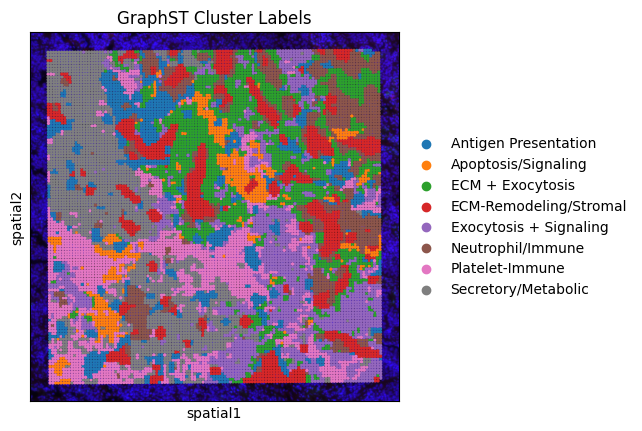

In [35]:
sc.pl.spatial(
    adata,
    color='domain_label',
    img_key='hires',
    title='GraphST Cluster Labels',
    spot_size=30,
    cmap='tab20'
)


In [36]:

marker_dict = {}
rank_res = adata.uns['rank_genes_groups']
groups = rank_res['names'].dtype.names

for group in groups:
    marker_dict[group] = [rank_res['names'][group][i] for i in range(2)]


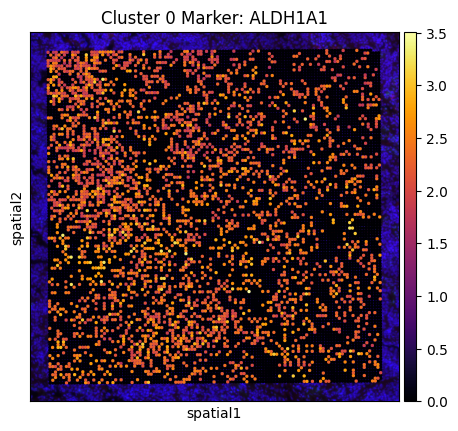

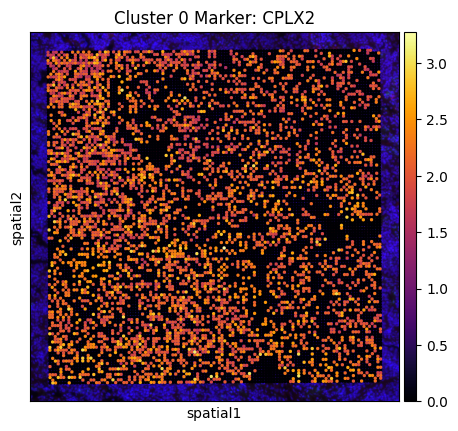

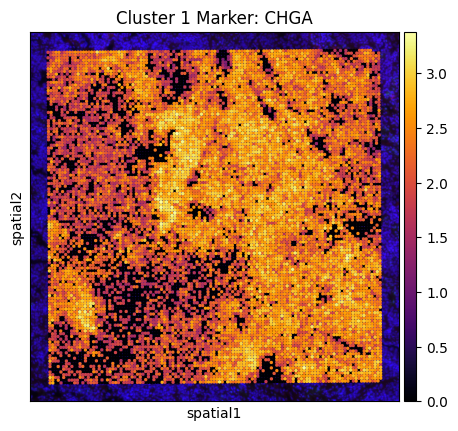

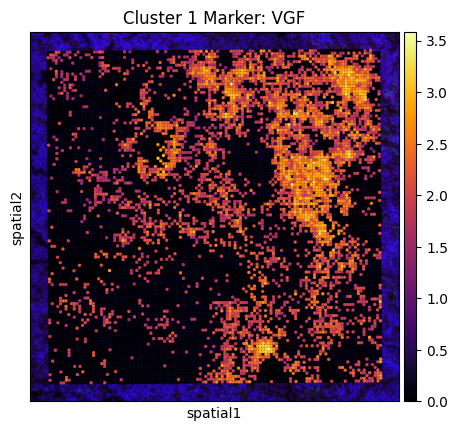

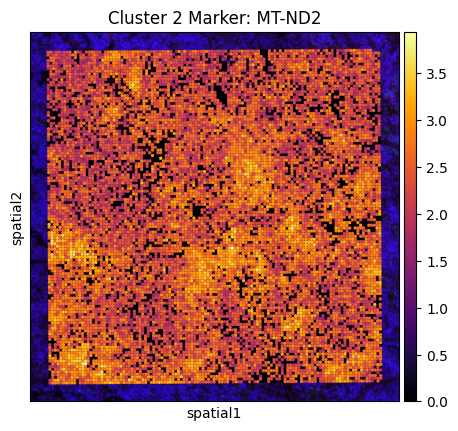

...

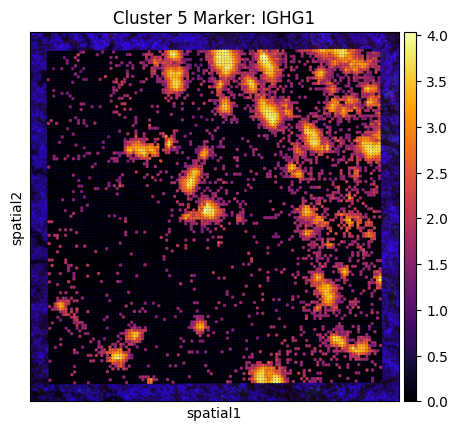

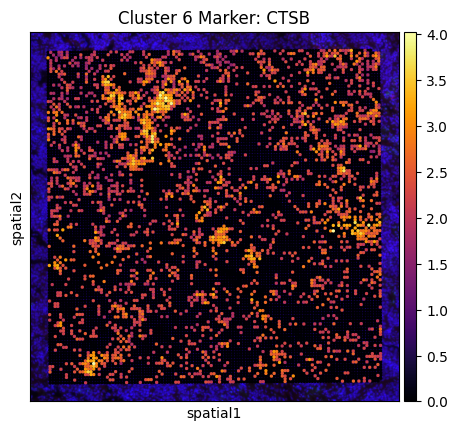

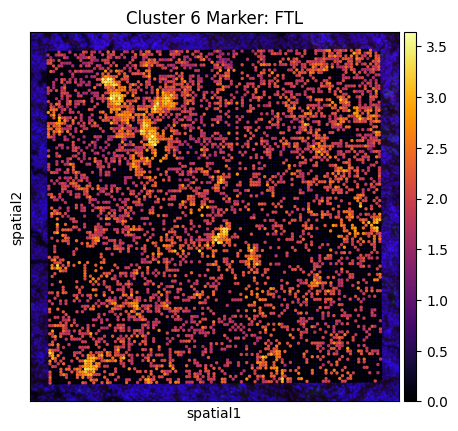

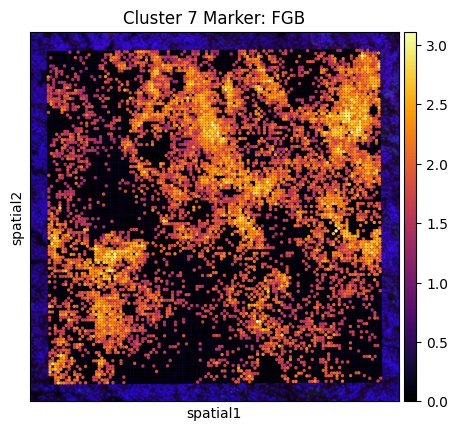

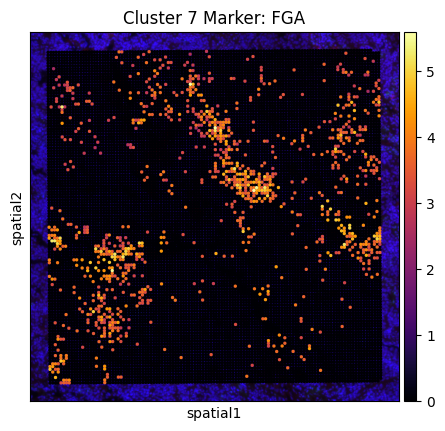

In [37]:
import matplotlib.pyplot as plt
import scanpy as sc

for cluster, genes in marker_dict.items():
    for gene in genes:
        sc.pl.spatial(
            adata,
            color=gene,
            img_key='hires',
            title=f"Cluster {cluster} Marker: {gene}",
            spot_size=30,
            cmap='inferno',  # or 'magma', 'viridis' etc.
            show=True
        )


In [38]:
# Compute average expression per cluster
mean_expr = adata.to_df().groupby(adata.obs['domain']).mean()


mean_expr.to_csv("graphst_cluster_avg_expr.csv")


C:\Users\suhas\AppData\Local\Temp\ipykernel_7408\2992604805.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_expr = adata.to_df().groupby(adata.obs['domain']).mean()


In [39]:
import pandas as pd

# Loading SingleR results
singleR_results = pd.read_csv("graphst_cluster_singleR_labels.csv", index_col=0)

label_map = singleR_results['labels'].to_dict()
adata.obs['SingleR_label'] = adata.obs['domain'].astype(str).map(label_map)


C:\Users\suhas\AppData\Local\Temp\ipykernel_7408\2654112460.py:12: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  adata.obs['SingleR_label'].fillna("Unlabeled", inplace=True)


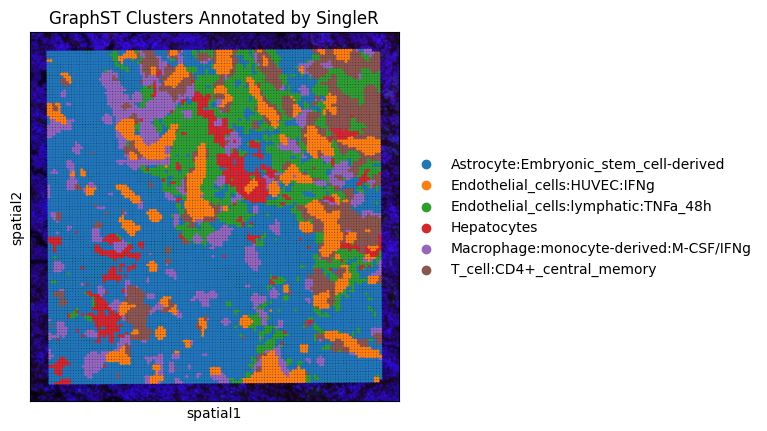

In [40]:
import pandas as pd
import scanpy as sc

# Load the SingleR results
singleR_results = pd.read_csv("graphst_cluster_singleR_labels.csv", index_col=0)


label_map = {str(i): label for i, label in enumerate(singleR_results['labels'].values)}


adata.obs['SingleR_label'] = adata.obs['domain'].astype(str).map(label_map)
adata.obs['SingleR_label'].fillna("Unlabeled", inplace=True)

# Plot spatial annotation
sc.pl.spatial(
    adata,
    color='SingleR_label',
    spot_size=30,
    title='GraphST Clusters Annotated by SingleR',
    legend_loc='right margin'
)


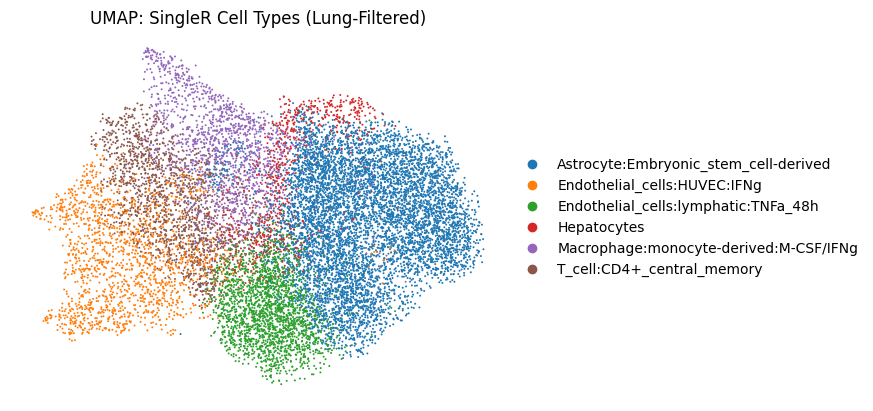

In [41]:
sc.pl.umap(
    adata,
    color='SingleR_label',
    title='UMAP: SingleR Cell Types (Lung-Filtered)',
    frameon=False
)


In [42]:
import gseapy as gp

# EMT: GO:0001837 (epithelial to mesenchymal transition)
emt_enrichr = gp.get_library(name='GO_Biological_Process_2021')
emt_genes = emt_enrichr['epithelial to mesenchymal transition (GO:0001837)']

# ECM remodeling: GO:0030198
ecm_genes = emt_enrichr['extracellular matrix organization (GO:0030198)']

# T cell activation: GO:0042110
tcell_genes = emt_enrichr['T cell activation (GO:0042110)']

In [43]:
sc.tl.score_genes(adata, gene_list=emt_genes, score_name='EMT_score')
sc.tl.score_genes(adata, gene_list=ecm_genes, score_name='ECM_score')
sc.tl.score_genes(adata, gene_list=tcell_genes, score_name='Tcell_score')


In [44]:
def filter_geneset(genes, adata):
    return [gene for gene in genes if gene in adata.var_names]
emt_genes_filtered = filter_geneset(emt_genes, adata)
ecm_genes_filtered = filter_geneset(ecm_genes, adata)
tcell_genes_filtered = filter_geneset(tcell_genes, adata)
sc.tl.score_genes(adata, emt_genes_filtered, score_name='EMT_score')
sc.tl.score_genes(adata, ecm_genes_filtered, score_name='ECM_score')
sc.tl.score_genes(adata, tcell_genes_filtered, score_name='Tcell_score')


In [45]:
print("EMT genes used:", len(emt_genes_filtered))
print("ECM genes used:", len(ecm_genes_filtered))
print("Tcell genes used:", len(tcell_genes_filtered))


EMT genes used: 44
ECM genes used: 293
Tcell genes used: 86


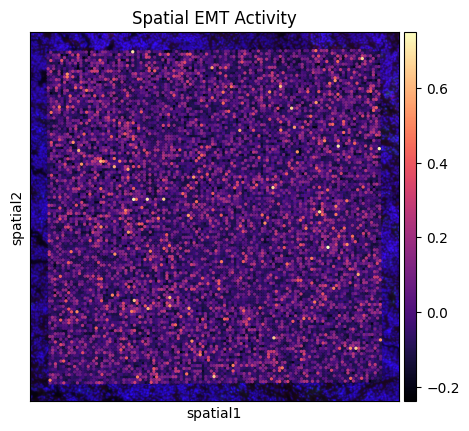

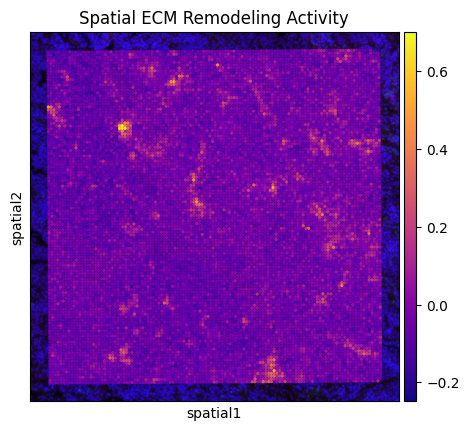

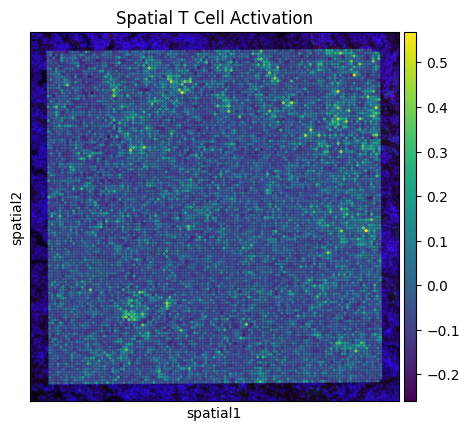

In [46]:
# EMT Activity
sc.pl.spatial(
    adata,
    color="EMT_score",
    cmap="magma",
    spot_size=30,
    title="Spatial EMT Activity"
)

# ECM Remodeling
sc.pl.spatial(
    adata,
    color="ECM_score",
    cmap="plasma",
    spot_size=30,
    title="Spatial ECM Remodeling Activity"
)

# T Cell Activation
sc.pl.spatial(
    adata,
    color="Tcell_score",
    cmap="viridis",
    spot_size=30,
    title="Spatial T Cell Activation"
)


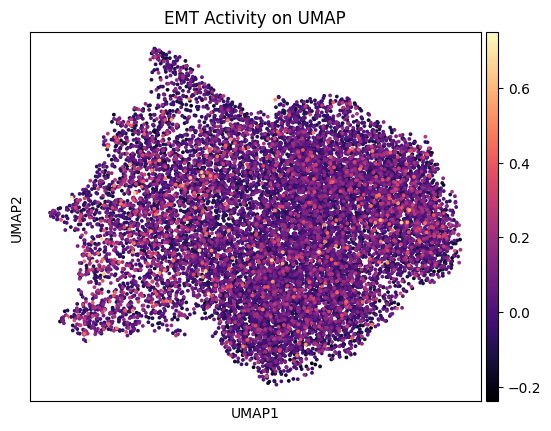

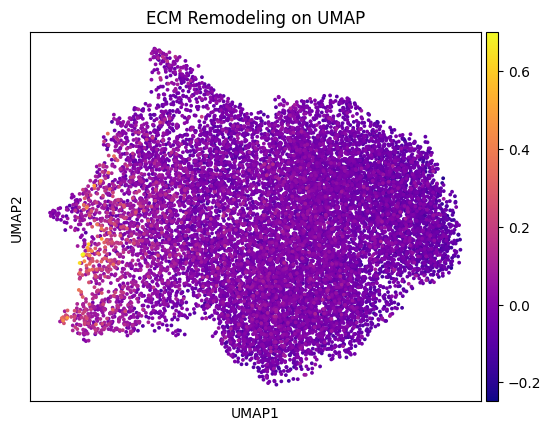

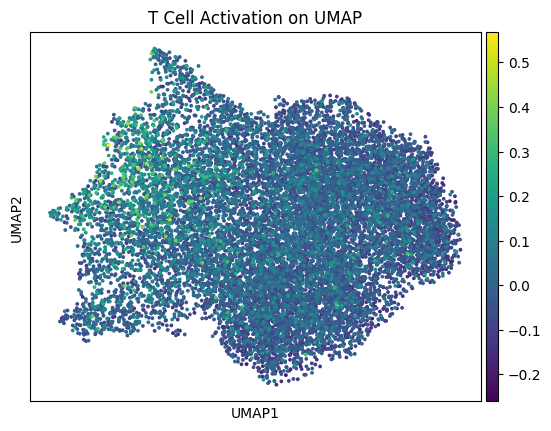

In [47]:
# EMT Score
sc.pl.umap(
    adata,
    color='EMT_score',
    cmap='magma',
    size=30,
    title="EMT Activity on UMAP",
    show=True
)

# ECM Score
sc.pl.umap(
    adata,
    color='ECM_score',
    cmap='plasma',
    size=30,
    title="ECM Remodeling on UMAP",
    show=True
)

# T Cell Score
sc.pl.umap(
    adata,
    color='Tcell_score',
    cmap='viridis',
    size=30,
    title="T Cell Activation on UMAP",
    show=True
)


        EMT_score  ECM_score  Tcell_score
domain                                   
0       -0.001374  -0.069839    -0.056449
1       -0.010911  -0.039839    -0.047743
2       -0.011730  -0.045503    -0.039858
3       -0.011255  -0.046145    -0.045151
4        0.032405   0.050158     0.004557
5        0.008467  -0.024564     0.033092
6       -0.007004  -0.031338    -0.011650
7       -0.010591  -0.031255    -0.045484


C:\Users\suhas\AppData\Local\Temp\ipykernel_7408\2893501933.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  summary = adata.obs.groupby("domain")[["EMT_score", "ECM_score", "Tcell_score"]].mean()


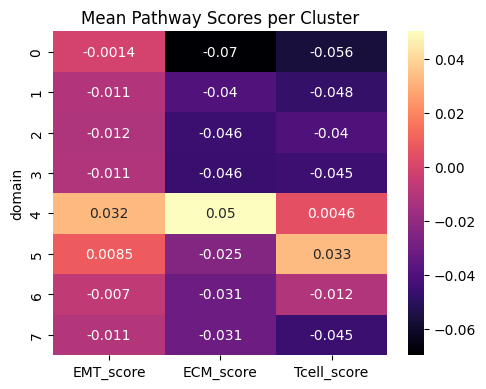

In [48]:
import pandas as pd
import seaborn as sns
# Compute mean scores per cluster
summary = adata.obs.groupby("domain")[["EMT_score", "ECM_score", "Tcell_score"]].mean()
print(summary)

# Plot as heatmap
plt.figure(figsize=(5,4))
sns.heatmap(summary, annot=True, cmap="magma")
plt.title("Mean Pathway Scores per Cluster")
plt.tight_layout()
plt.show()


In [49]:
sc.pp.scale(adata, zero_center=True, max_value=5)
mean_expr = adata.to_df()[top_genes].groupby(adata.obs["domain"]).mean()


C:\Users\suhas\AppData\Local\Temp\ipykernel_7408\1998322617.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_expr = adata.to_df()[top_genes].groupby(adata.obs["domain"]).mean()


In [50]:
print(mean_expr)


            IGKC     IGHG1     IGLC1     IGHG3    JCHAIN       VGF       FGB  \
domain                                                                         
0      -0.447213 -0.438777 -0.189993 -0.131205 -0.208464 -0.345854 -0.390583   
1       0.057608  0.032776 -0.087518 -0.041942 -0.129606  0.769567  0.582289   
2      -0.402701 -0.397434 -0.193868 -0.125648 -0.215024 -0.421680 -0.138461   
3      -0.261656 -0.241528 -0.182430 -0.111015 -0.189791  0.079843 -0.370846   
4       1.015106  0.951563  0.497694  0.321454  0.851204 -0.018431 -0.232377   
5       0.890196  0.943736  0.525424  0.101753  0.379148  0.293621  0.322117   
6      -0.191660 -0.207338 -0.149447 -0.119089 -0.146797 -0.183849 -0.047838   
7      -0.399159 -0.371718 -0.151116 -0.108672 -0.207019 -0.205764  1.085678   

            RGS5     IGHA1      CD74    IGFBP3      IGHM       CGA    TMSB4X  \
domain                                                                         
0      -0.102795 -0.099046 -0.269160 -0

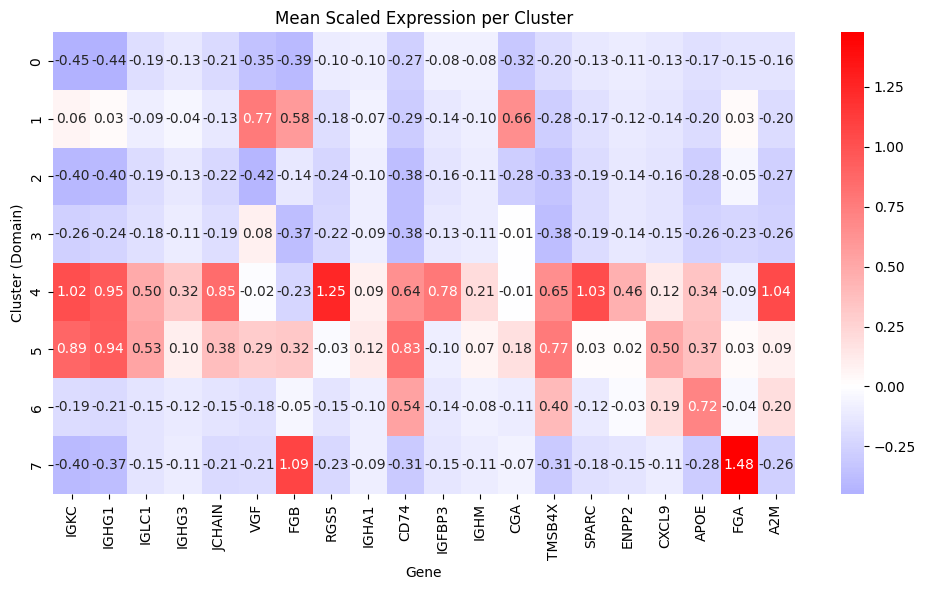

In [51]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
sns.heatmap(mean_expr, cmap="bwr", center=0, annot=True, fmt=".2f")  # `center=0` for diverging
plt.title("Mean Scaled Expression per Cluster")
plt.ylabel("Cluster (Domain)")
plt.xlabel("Gene")
plt.tight_layout()
plt.show()


In [52]:
adata

AnnData object with n_obs × n_vars = 14880 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'leiden', 'domain', 'domain_label', 'SingleR_label', 'EMT_score', 'ECM_score', 'Tcell_score'
    var: 'gene_ids', 'feature_types', 'genome', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'spatial', 'hvg', 'log1p', 'neighbors', 'leiden', 'umap', 'domain_colors', 'rank_genes_groups', 'spatial_neighbors', 'moranI', 'domain_co_occurrence', 'domain_nhood_enrichment', 'paga', 'domain_sizes', 'domain_label_colors', 'SingleR_label_colors'
    obsm: 'spatial', 'distance_matrix', 'graph_neigh', 'adj', 'label_CSL', 'feat', 'feat_a', 'emb', 'emb_pca', 'X_umap'
    obsp: 'distances', 'connectivities', 'spatial_connectivities', 'spatial_distances'

In [53]:
adata

AnnData object with n_obs × n_vars = 14880 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'leiden', 'domain', 'domain_label', 'SingleR_label', 'EMT_score', 'ECM_score', 'Tcell_score'
    var: 'gene_ids', 'feature_types', 'genome', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'spatial', 'hvg', 'log1p', 'neighbors', 'leiden', 'umap', 'domain_colors', 'rank_genes_groups', 'spatial_neighbors', 'moranI', 'domain_co_occurrence', 'domain_nhood_enrichment', 'paga', 'domain_sizes', 'domain_label_colors', 'SingleR_label_colors'
    obsm: 'spatial', 'distance_matrix', 'graph_neigh', 'adj', 'label_CSL', 'feat', 'feat_a', 'emb', 'emb_pca', 'X_umap'
    obsp: 'distances', 'connectivities', 'spatial_connectivities', 'spatial_distances'

In [72]:
from celltypist import models

# List all available models
x = models.download_models()
print(x)

None


In [73]:
from celltypist import models

# Show available model list without requiring internet fetch
models.models_description(on_the_fly=False)


,model,description
0,Immune_All_Low.pkl,immune sub-populations combined from 20 tissue...
1,Immune_All_High.pkl,immune populations combined from 20 tissues of...
2,Adult_COVID19_PBMC.pkl,peripheral blood mononuclear cell types from C...
3,Adult_CynomolgusMacaque_Hippocampus.pkl,cell types from the hippocampus of adult cynom...
4,Adult_Human_MTG.pkl,cell types and subtypes (10x-based) from the a...
5,Adult_Human_PancreaticIslet.pkl,cell types from pancreatic islets of healthy a...
6,Adult_Human_PrefrontalCortex.pkl,cell types and subtypes from the adult human d...
7,Adult_Human_Skin.pkl,cell types from human healthy adult skin
8,Adult_Human_Vascular.pkl,vascular populations combined from multiple ad...
9,Adult_Mouse_Gut.pkl,cell types in the adult mouse gut combined fro...


In [58]:
adata

AnnData object with n_obs × n_vars = 14880 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'leiden', 'domain', 'domain_label', 'SingleR_label', 'EMT_score', 'ECM_score', 'Tcell_score'
    var: 'gene_ids', 'feature_types', 'genome', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'spatial', 'hvg', 'log1p', 'neighbors', 'leiden', 'umap', 'domain_colors', 'rank_genes_groups', 'spatial_neighbors', 'moranI', 'domain_co_occurrence', 'domain_nhood_enrichment', 'paga', 'domain_sizes', 'domain_label_colors', 'SingleR_label_colors'
    obsm: 'spatial', 'distance_matrix', 'graph_neigh', 'adj', 'label_CSL', 'feat', 'feat_a', 'emb', 'emb_pca', 'X_umap'
    obsp: 'distances', 'connectivities', 'spatial_connectivities', 'spatial_distances'

In [59]:
import numpy as np, scipy.sparse as sp
X = adata.X.tocsr() if sp.issparse(adata.X) else sp.csr_matrix(adata.X)
print("shape:", adata.shape)
print("min/max (computed):", 0.0, float(X.max()))
print("any NaN in data?:", np.isnan(X.data).any())
print("any +/-inf in data?:", np.isinf(X.data).any())
print("domain present:", "domain" in adata.obs, "n_unique:", adata.obs["domain"].nunique() if "domain" in adata.obs else None)


shape: (14880, 18085)
min/max (computed): 0.0 10.24434572778725
any NaN in data?: False
any +/-inf in data?: False
domain present: True n_unique: 8


In [55]:
import pandas as pd

# Count cells/spots per cluster
cluster_counts = adata.obs['domain'].value_counts(normalize=False)
print(cluster_counts)


domain
0    2763
1    2203
2    2164
3    2138
4    1675
5    1620
6    1552
7     765
Name: count, dtype: int64


In [54]:
import pandas as pd

# Load signature CSV
signatures = pd.read_csv("signatures.csv")

# Preview
print(signatures.head())


  TLS_mature    TLS TGFB_CAFs    CAF ecm_myCAF detox_iCAF IL_iCAF TGFβ_myCAF  \
0        CR2    TSG     MMP11   ENAH      ASPN      ADH1B   ITM2A       CST1   
1      FCER2  CXCR5   COL11A1  ITGB1    COL3A1         C7  CXCL12      LAMP5   
2     CXCL13   CCR7   C1QTNF3  ACTA2      THY1     CXCL12    FIGF      LOXL1   
3       BCL6  CD79B   COL12A1    FAP     SFRP2       TNXB   FXYD1      EDNRA   
4      MS4A1  CCL18   COL10A1    IL6   COL10A1      RSPO3   PLPP3      TGFB1   

  wound_myCAF IFNγ_iCAF  
0       SFRP4     CCL19  
1      CCDC80     VCAM1  
2         OGN      RBP5  
3         DCN    CYP1B1  
4      PTGER3        C7  


In [77]:

signatures.dropna(how="all", inplace=True)


signature_dict = {}

for col in signatures.columns:
 
    genes = signatures[col].dropna().tolist()
    signature_dict[col] = genes

# Preview
print({k: signature_dict[k][:15] for k in signature_dict})


{'TLS_mature': ['CR2', 'FCER2', 'CXCL13', 'BCL6', 'MS4A1', 'AICDA'], 'TLS': ['TSG', 'CXCR5', 'CCR7', 'CD79B', 'CCL18', 'CCL21', 'CXCR4', 'CCL5', 'CXCL9', 'CXCL10', 'CCL19', 'CXCL13', 'SELL', 'CD86', 'LTB'], 'TGFB_CAFs': ['MMP11', 'COL11A1', 'C1QTNF3', 'COL12A1', 'COL10A1', 'COL5A2', 'THBS2', 'CTHRC1', 'AEBP1', 'RRC15', 'ENAH', 'RAB8A', 'SEC22B', 'ATG7'], 'CAF': ['ENAH', 'ITGB1', 'ACTA2', 'FAP', 'IL6', 'TGFB1', 'CXCL12', 'CCL2', 'YAP1'], 'ecm_myCAF': ['ASPN', 'COL3A1', 'THY1', 'SFRP2', 'COL10A1', 'COL6A3', 'LRRC17', 'CILP', 'GRP', 'ITGBL1', 'COL8A1', 'COL14A1', 'ADAM12', 'OLFML2B', 'ELN'], 'detox_iCAF': ['ADH1B', 'C7', 'CXCL12', 'TNXB', 'RSPO3', 'DCN', 'C16orf89', 'GDF10', 'PAMR1', 'FXYD1', 'ZBTB16', 'SLIT3', 'HSPB6', 'IL6', 'FBLN5'], 'IL_iCAF': ['ITM2A', 'CXCL12', 'FIGF', 'FXYD1', 'PLPP3', 'TNFRSF10D', 'CTB-92J24.3', 'LAMC3', 'C7', 'ZBTB16', 'CAPN6', 'SCARA5', 'DLK1', 'MEG3', 'TAC1'], 'TGFβ_myCAF': ['CST1', 'LAMP5', 'LOXL1', 'EDNRA', 'TGFB1', 'TGFB3', 'TNN', 'CST2', 'HES4', 'COL10A1', 

In [57]:
from sklearn.preprocessing import scale
import numpy as np

# Z-score normalize (genes along axis=0)
adata.X = scale(adata.X, axis=0)


for sig, gene_list in signature_dict.items():
    valid_genes = [g for g in gene_list if g in adata.var_names]
    if valid_genes:
        adata.obs[f"{sig}_score"] = adata[:, valid_genes].X.mean(axis=1)
    else:
        print(f"Signature '{sig}' has no matching genes in adata.")


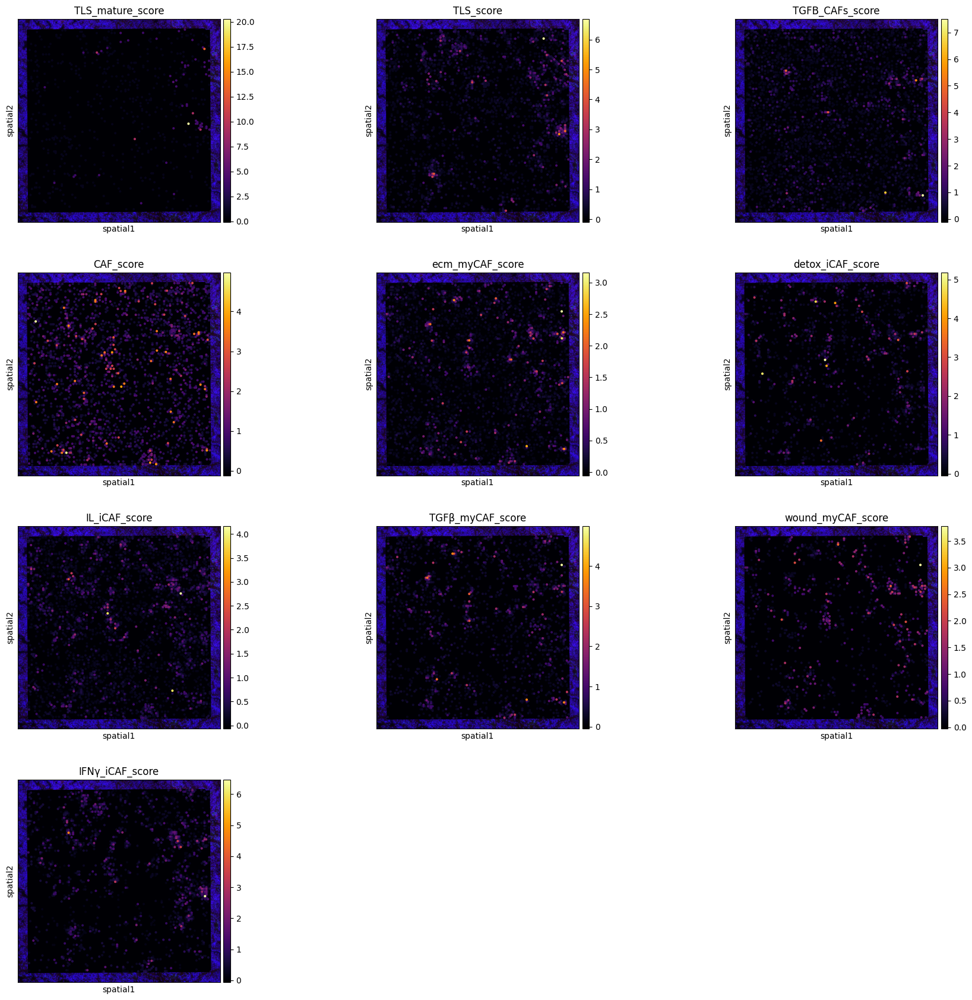

In [58]:
sc.pl.spatial(
    adata,
    color=[f"{sig}_score" for sig in signature_dict],
    cmap="inferno",
    ncols=3,
    spot_size=40
)


In [59]:
import pandas as pd


signature_score_cols = [f"{sig}_score" for sig in signature_dict.keys()]


adata.obs["niche_type"] = adata.obs[signature_score_cols].idxmax(axis=1)


adata.obs["niche_type"] = adata.obs["niche_type"].str.replace("_score", "")


In [60]:
import numpy as np
from scipy.spatial import cKDTree


coords = adata.obsm["spatial"]
labels = adata.obs["domain"].astype(int)


green_indices = np.where(labels == 2)[0]
red_coords = coords[labels == 3]


tree = cKDTree(red_coords)


radius = 50 
green_near_red = []
for idx in green_indices:
    dist, _ = tree.query(coords[idx], distance_upper_bound=radius)
    green_near_red.append(np.isfinite(dist))


adata.obs["green_in_red"] = False
adata.obs.iloc[np.array(green_indices)[green_near_red], adata.obs.columns.get_loc("green_in_red")] = True


print(adata.obs["green_in_red"].value_counts())


green_in_red
False    14054
True       826
Name: count, dtype: int64


In [61]:

for sig, gene_list in signature_dict.items():
    valid_genes = [g for g in gene_list if g in adata.var_names]
    if valid_genes:
        adata.obs[f"{sig}_score"] = adata[:, valid_genes].X.mean(axis=1)


In [62]:
score_cols = [f"{sig}_score" for sig in signature_dict.keys()]


In [63]:

green_red_spots = adata.obs[adata.obs["green_in_red"] == True].copy()

green_scores = green_red_spots[score_cols]

green_red_spots["predicted_signature"] = green_scores.idxmax(axis=1).str.replace("_score", "")


In [64]:
print(green_red_spots["predicted_signature"].value_counts())


predicted_signature
wound_myCAF    439
ecm_myCAF       81
TGFB_CAFs       80
CAF             61
IL_iCAF         45
TGFβ_myCAF      41
TLS             31
TLS_mature      21
detox_iCAF      17
IFNγ_iCAF       10
Name: count, dtype: int64


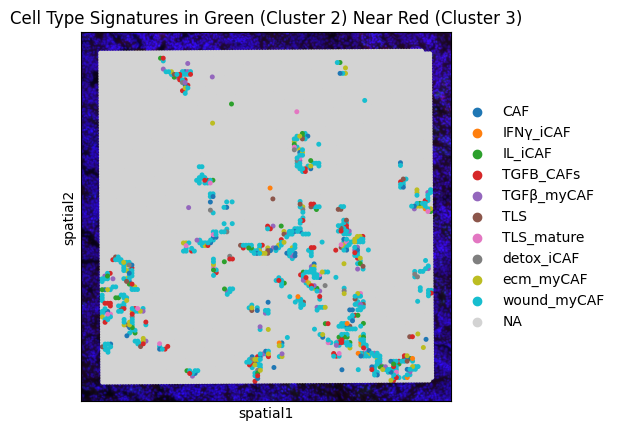

In [65]:

adata.obs["green_niche_type"] = None
adata.obs.loc[green_red_spots.index, "green_niche_type"] = green_red_spots["predicted_signature"]

sc.pl.spatial(
    adata,
    color="green_niche_type",
    title="Cell Type Signatures in Green (Cluster 2) Near Red (Cluster 3)",
    spot_size=45,
    na_color="lightgrey",
)


In [66]:
from scipy.spatial import cKDTree
import numpy as np

# Coordinates
coords = adata.obsm["spatial"]
labels = adata.obs["domain"].astype(int)


niche_cluster_ids = [4, 5, 6,7]
host_cluster_ids = [0,1, 2, 3]


niche_indices = np.where(np.isin(labels, niche_cluster_ids))[0]
host_coords = coords[np.isin(labels, host_cluster_ids)]

# Build KDTree of host clusters
tree = cKDTree(host_coords)


radius = 50


niche_near_host = []
for idx in niche_indices:
    dist, _ = tree.query(coords[idx], distance_upper_bound=radius)
    niche_near_host.append(np.isfinite(dist))

adata.obs["niche_in_host123"] = False
adata.obs.iloc[np.array(niche_indices)[niche_near_host], adata.obs.columns.get_loc("niche_in_host123")] = True


In [67]:

adata.obs["niche_type_in_host123"] = None
adata.obs.loc[adata.obs["niche_in_host123"], "niche_type_in_host123"] = adata.obs["niche_type"]


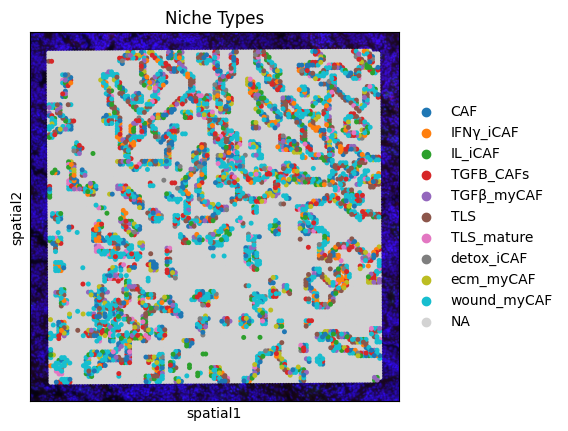

In [68]:

adata.obs["niche_type_in_host123"] = adata.obs["niche_type_in_host123"].astype("category")

sc.pl.spatial(
    adata,
    color="niche_type_in_host123",
    title="Niche Types",
    spot_size=45,
    na_color="lightgrey"
)


In [69]:
adata

AnnData object with n_obs × n_vars = 14880 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'leiden', 'domain', 'domain_label', 'SingleR_label', 'EMT_score', 'ECM_score', 'Tcell_score', 'TLS_mature_score', 'TLS_score', 'TGFB_CAFs_score', 'CAF_score', 'ecm_myCAF_score', 'detox_iCAF_score', 'IL_iCAF_score', 'TGFβ_myCAF_score', 'wound_myCAF_score', 'IFNγ_iCAF_score', 'niche_type', 'green_in_red', 'green_niche_type', 'niche_in_host123', 'niche_type_in_host123'
    var: 'gene_ids', 'feature_types', 'genome', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'spatial', 'hvg', 'log1p', 'neighbors', 'leiden', 'umap', 'domain_colors', 'rank_genes_groups', 'spatial_neighbors', 'moranI', 'domain_co_occurrence', 'domain_nhood_enrichment', 'paga', 'domain_sizes', 'domain_label_colors', 'SingleR_label_colors', 'green_niche_type_colors', 'niche_type_in_host123_colors'
    obsm: 'spatial', 'distance_matrix', 'graph_neigh', 'adj', 'label_CS

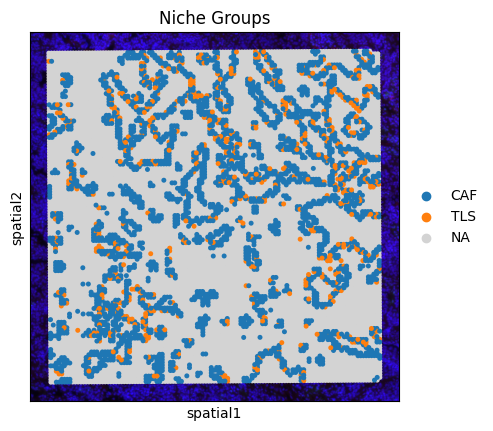

In [70]:
import pandas as pd

map_dict = {
    "CAF": "CAF",
    "IFNγ_iCAF": "CAF",
    "IL_iCAF": "CAF",
    "TGFB_CAFs": "CAF",
    "TGFB_myCAF": "CAF",
    "ecm_myCAF": "CAF",
    "wound_myCAF": "CAF",
    "detox_iCAF": "CAF",
    
    "TLS": "TLS",
    "TLS_mature": "TLS",
    
    "NA": "NA"  
}


adata.obs["niche_group"] = adata.obs["niche_type_in_host123"].map(map_dict)
adata.obs["niche_group"] = adata.obs["niche_group"].astype("category")


sc.pl.spatial(
    adata,
    color="niche_group",
    title="Niche Groups",
    spot_size=45,
    na_color="lightgrey"
)


In [71]:
adata


AnnData object with n_obs × n_vars = 14880 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'leiden', 'domain', 'domain_label', 'SingleR_label', 'EMT_score', 'ECM_score', 'Tcell_score', 'TLS_mature_score', 'TLS_score', 'TGFB_CAFs_score', 'CAF_score', 'ecm_myCAF_score', 'detox_iCAF_score', 'IL_iCAF_score', 'TGFβ_myCAF_score', 'wound_myCAF_score', 'IFNγ_iCAF_score', 'niche_type', 'green_in_red', 'green_niche_type', 'niche_in_host123', 'niche_type_in_host123', 'niche_group'
    var: 'gene_ids', 'feature_types', 'genome', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'spatial', 'hvg', 'log1p', 'neighbors', 'leiden', 'umap', 'domain_colors', 'rank_genes_groups', 'spatial_neighbors', 'moranI', 'domain_co_occurrence', 'domain_nhood_enrichment', 'paga', 'domain_sizes', 'domain_label_colors', 'SingleR_label_colors', 'green_niche_type_colors', 'niche_type_in_host123_colors', 'niche_group_colors'
    obsm: 'spatial', 'distance_mat

In [72]:
import pandas as pd
import numpy as np


latent_key_candidates = ['emb', 'emb_pca', 'feat', 'feat_a']
latent_key = next((k for k in latent_key_candidates if k in adata.obsm), None)
if latent_key is None:
    raise KeyError("No latent found in obsm among: 'emb', 'emb_pca', 'feat', 'feat_a'.")

pd.DataFrame(adata.obsm[latent_key], index=adata.obs_names)\
  .to_csv(r"D:\graphst_latent.csv")

adata.obs['domain'].astype(str).rename('graphst_domain')\
  .to_csv(r"D:\graphst_domain.csv")
adata.obs['leiden'].astype(str).rename('graphst_leiden')\
  .to_csv(r"D:\graphst_leiden.csv")


coords = pd.DataFrame(adata.obsm['spatial'], index=adata.obs_names, columns=['x','y'])
coords.to_csv(r"D:\coords.csv")


In [73]:
import pandas as pd


df = adata.to_df()
df["domain"] = adata.obs["domain"].values

cluster_genes = (
    df.groupby("domain")
    .apply(lambda g: g.drop(columns="domain").loc[:, (g.drop(columns="domain") > 0).any()].columns.tolist())
)


cluster_genes_df = cluster_genes.reset_index()
cluster_genes_df.columns = ["domain", "genes"]

# Save as CSV
cluster_genes_df.to_csv("cluster_genes.csv", index=False)

print("Saved cluster_genes.csv with genes present in each cluster")


C:\Users\suhas\AppData\Local\Temp\ipykernel_7408\785745271.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby("domain")


Saved cluster_genes.csv with genes present in each cluster


C:\Users\suhas\AppData\Local\Temp\ipykernel_7408\785745271.py:8: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df.groupby("domain")


In [76]:
import pandas as pd
import numpy as np
from scipy import sparse

cluster_key = "leiden"  
X = adata.X
var_names = adata.var_names
rows = []

for cl in sorted(adata.obs[cluster_key].unique()):
    idx = np.where(adata.obs[cluster_key].values == cl)[0]

    if sparse.issparse(X):
        expressed = np.asarray((X[idx, :].sum(axis=0) > 0)).ravel()
    else:
        expressed = (X[idx, :].sum(axis=0) > 0)

    genes = var_names[expressed]

    for g in genes:
        rows.append({"cluster": cl, "gene": g})

cluster_genes_df = pd.DataFrame(rows)
cluster_genes_df.to_csv("cluster_genes_per_cluster_long.csv", index=False)

print(" Saved cluster_genes_per_cluster_long.csv (one gene per row)")


 Saved cluster_genes_per_cluster_long.csv (one gene per row)
